## Config

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install zarr
!pip install l5kit
!pip install colorama
!pip install -U PyYAML

Requirement already up-to-date: PyYAML in /usr/local/lib/python3.7/dist-packages (5.4.1)


In [ ]:
import os, gc
import zarr
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import l5kit
import psutil
import os
import random
import time
import pprint
from tqdm import tqdm
import tqdm.notebook as tq
from typing import Dict
from collections import Counter
from prettytable import PrettyTable
import warnings
warnings.filterwarnings("ignore")
from matplotlib import animation, rc
from IPython.display import HTML, display

rc('animation', html='jshtml')
import matplotlib.patches as mpatches


#level5 toolkit
from l5kit.data import labels
from l5kit.dataset import EgoDataset, AgentDataset
from l5kit.data import ChunkedDataset, LocalDataManager

# level5 toolkit 
from l5kit.configs import load_config_data
from l5kit.geometry import transform_points
from l5kit.rasterization import build_rasterizer
from l5kit.visualization import draw_trajectory, draw_reference_trajectory, TARGET_POINTS_COLOR
from l5kit.evaluation import write_pred_csv, compute_metrics_csv, read_gt_csv, create_chopped_dataset
from l5kit.evaluation import *
from l5kit.kinematic import AckermanPerturbation
from l5kit.random import GaussianRandomGenerator

# visualization
from matplotlib import animation
from colorama import Fore, Back, Style

# deep learning
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision.models.resnet import resnet18, resnet50, resnet34

## Load submission into dataframe

In [ ]:
df_sub = pd.read_csv('/content/drive/MyDrive/lyft-motion-prediction-autonomous-vehicles/results/batches/submission_B6_2.csv')
df_sub = df_sub.set_index(['timestamp', 'track_id'])

In [ ]:
display(df_sub)

conf_0    conf_1  ...  coord_x249  coord_y249
timestamp           track_id                      ...                        
1578606007801600134 2         1.000000  0.000000  ...     0.00000     0.00000
1578606032802467516 4         1.000000  0.000000  ...     0.00000     0.00000
                    5         1.000000  0.000000  ...     0.00000     0.00000
                    81        1.000000  0.000000  ...     0.00000     0.00000
                    130       1.000000  0.000000  ...     0.00000     0.00000
...                                ...       ...  ...         ...         ...
1583863581802681726 253       0.436756  0.221933  ...    22.15625    22.53125
1583863606802928836 1         0.487915  0.248231  ...   -10.14844   -28.92188
                    6         0.468995  0.358977  ...    -5.37891   -10.92969
                    213       0.439993  0.239395  ...     2.63281    26.10938
                    250       0.016376  0.978118  ...     2.00977    14.52344

[71122 rows x 303 columns]

In [ ]:
display(df_sub)

conf_0    conf_1  ...  coord_x249  coord_y249
timestamp           track_id                      ...                        
1578606007801600134 2         1.000000  0.000000  ...     0.00000     0.00000
1578606032802467516 4         1.000000  0.000000  ...     0.00000     0.00000
                    5         1.000000  0.000000  ...     0.00000     0.00000
                    81        1.000000  0.000000  ...     0.00000     0.00000
                    130       1.000000  0.000000  ...     0.00000     0.00000
...                                ...       ...  ...         ...         ...
1583863581802681726 253       0.436756  0.221933  ...    22.15625    22.53125
1583863606802928836 1         0.487915  0.248231  ...   -10.14844   -28.92188
                    6         0.468995  0.358977  ...    -5.37891   -10.92969
                    213       0.439993  0.239395  ...     2.63281    26.10938
                    250       0.016376  0.978118  ...     2.00977    14.52344

[71122 rows x 303 columns]

## Load test data 

In [ ]:
# set env variable for data
DIR_INPUT = "/content/drive/MyDrive/lyft-motion-prediction-autonomous-vehicles/"
cfg = load_config_data("/content/drive/MyDrive/lyft-motion-prediction-autonomous-vehicles/config.yaml")
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)

In [ ]:
dm = LocalDataManager()
zarr_dataset = ChunkedDataset(dm.require(cfg['test_data_loader']['key'])).open()
print(zarr_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   11314    |  1131400   |  88594921  |    7854144    |      31.43      |        100.00        |        78.31         |        10.00         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [ ]:
# Semantic view
cfg['raster_params']['map_type'] = 'py_semantic'
semantic_rasterizer = build_rasterizer(cfg, dm)

# Satellite view
cfg['raster_params']['map_type'] = 'py_satellite'
satellite_rasterizer = build_rasterizer(cfg, dm)

In [ ]:
semantic_dataset = EgoDataset(cfg, zarr_dataset, semantic_rasterizer)
satellite_dataset = EgoDataset(cfg, zarr_dataset, satellite_rasterizer)
test_mask = np.load(f"{DIR_INPUT}/scenes/mask.npz")["arr_0"]
agent_semantic_dataset = AgentDataset(cfg, zarr_dataset, semantic_rasterizer, agents_mask=test_mask)
agent_satellite_dataset = AgentDataset(cfg, zarr_dataset, satellite_rasterizer, agents_mask=test_mask)

In [ ]:
# here I use matplotlib default colors
cmap = plt.get_cmap("tab10")
matplotlib_colors_in_rgb_int = [
    [int(255 * x) for x in cmap(i)[:3]] for i in range(10)
]

# Visualizations

## Handles our visuals

In [ ]:
def animate(images):
    fig = plt.figure()
    ims = [(plt.imshow(im, animated=True, origin='lower'),) for im in images]
    anim = animation.ArtistAnimation(fig, ims, interval=60, blit=True, repeat_delay=1000)
    plt.close()
    return HTML(anim.to_jshtml())

def plot_scene(dataset, scene_id):
    indices = dataset.get_scene_indices(scene_id)
    print('scene', scene_id, ':', indices[0], '-', indices[-1])
    images = [generate_image_trajectory(dataset, i) for i in indices]
    return animate(images)

import bisect
def get_scene_index_from_frame_id(dataset, frame_id):
    return bisect.bisect_right(dataset.cumulative_sizes, frame_id)

In [ ]:
def row_to_confs(row):
    return [row[f'conf_{i}'] for i in range(3)]
def row_to_coords(row):
    return row[3:].values.reshape(3, 50, 2)

In [ ]:
raster_params = cfg['raster_params']
raster_from_agent = np.array([
    [2., 0.,  56.],
    [0., 2., 112.],
    [0., 0.,   1.],
]) if (
    raster_params['raster_size'] == [224, 224] and
    raster_params['pixel_size'] == [0.5, 0.5] and
    raster_params['ego_center'] == [0.25, 0.5]
) else None
    
def generate_image_trajectory(dataset, index):
    data = dataset[index]
    im = data['image'].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    rfg = raster_from_agent if raster_from_agent is not None else data['raster_from_agent']
    target_positions_pixels = transform_points(data['target_positions'], rfg)
    draw_trajectory(im, target_positions_pixels, yaws=data['target_yaws'], rgb_color=TARGET_POINTS_COLOR)
    return im

def plot_trajectory(dataset, indices, width=20, height=10, n_cols=3, title=''):
    if not isinstance(indices, (list, np.ndarray)):
        indices = [indices]
    n_rows = len(indices) // n_cols + len(indices) % n_cols
    plt.figure(figsize=(width, height*n_rows))
    for k, index in enumerate(indices):
        plt.subplot(n_rows, n_cols, 1+k).set_title(str(index))
        im = generate_image_trajectory(dataset, index)
        plt.imshow(im, origin='lower')
    if title:
        plt.suptitle(title)
    plt.show()

def generate_image_predicted_trajectory(dataset, df_sub, index):
    data = dataset[index]
    im = data['image'].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    row = df_sub.loc[(data['timestamp'], data['track_id'])]
    # note submission coordinate system = world - centroid
    predicted_target_positions_in_sub = row_to_coords(row)
    predicted_target_positions_in_world = predicted_target_positions_in_sub + data['centroid']
    for i, coords in enumerate(predicted_target_positions_in_world):
        target_positions_pixels = transform_points(coords, data['raster_from_world'])
        draw_trajectory(im, target_positions_pixels, rgb_color=matplotlib_colors_in_rgb_int[i])
    return im, row_to_confs(row)

def plot_predicted_trajectory(dataset, df_sub, indices, width=12, height=4, n_cols=3, title=''):
    if not isinstance(indices, (list, np.ndarray)):
        indices = [indices]
    n_rows = len(indices) // n_cols + len(indices) % n_cols
    plt.figure(figsize=(width, height*n_rows))
    for k, index in enumerate(indices):
        plt.subplot(n_rows, n_cols, 1+k).set_title(str(index))
        im, confs = generate_image_predicted_trajectory(dataset, df_sub, index)
        patches = [mpatches.Patch(color=cmap(m), label='%.3f'%conf) for m, conf in enumerate(confs)]
        plt.imshow(im, origin='lower')
        plt.legend(handles=patches)
    if title:
        plt.suptitle(title)
    plt.show()

## Here are predictions

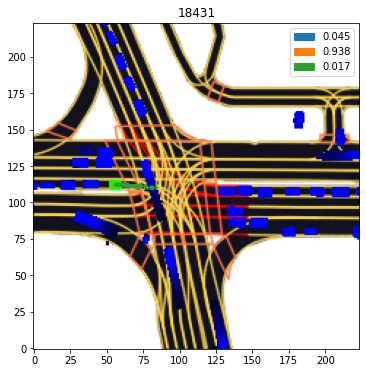

In [ ]:
plot_predicted_trajectory(agent_semantic_dataset, df_sub, [18431], width=10, height=6, n_cols=1)

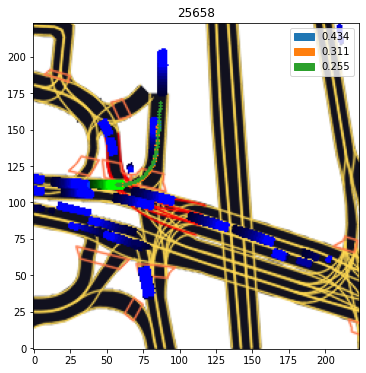

In [ ]:
plot_predicted_trajectory(agent_semantic_dataset, df_sub, 25658, width=10, height=6, n_cols=1)

In [ ]:
i_plots = list(range(5311, 5500))
# i_plots = (i_plots - i_plots[0] + 18552) % len(agent_semantic_dataset)
#i_plots

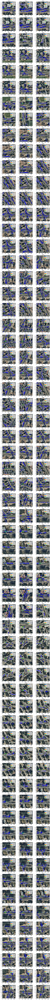

In [ ]:
plot_predicted_trajectory(agent_satellite_dataset, df_sub, i_plots)

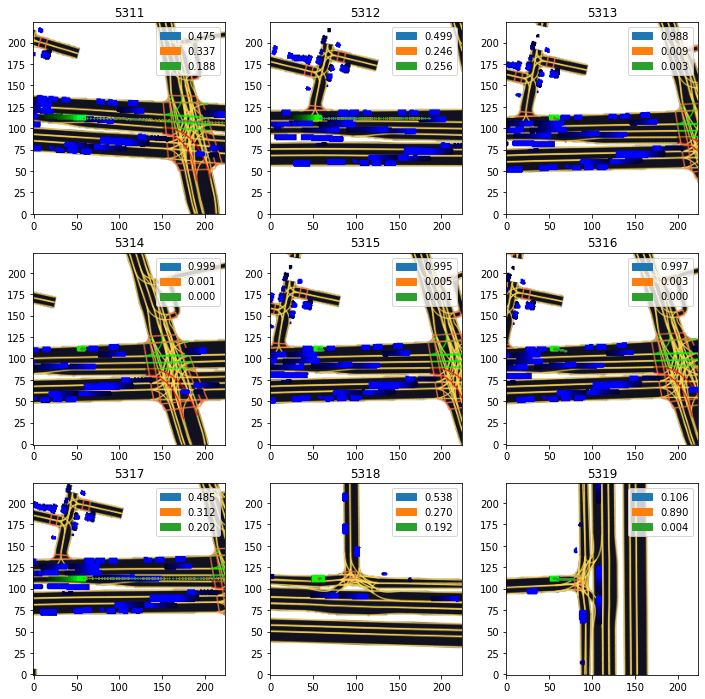

In [ ]:
# note in the test set the each agent only have very few frames.
plot_predicted_trajectory(agent_semantic_dataset, df_sub, list(range(5311, 5311+9)))

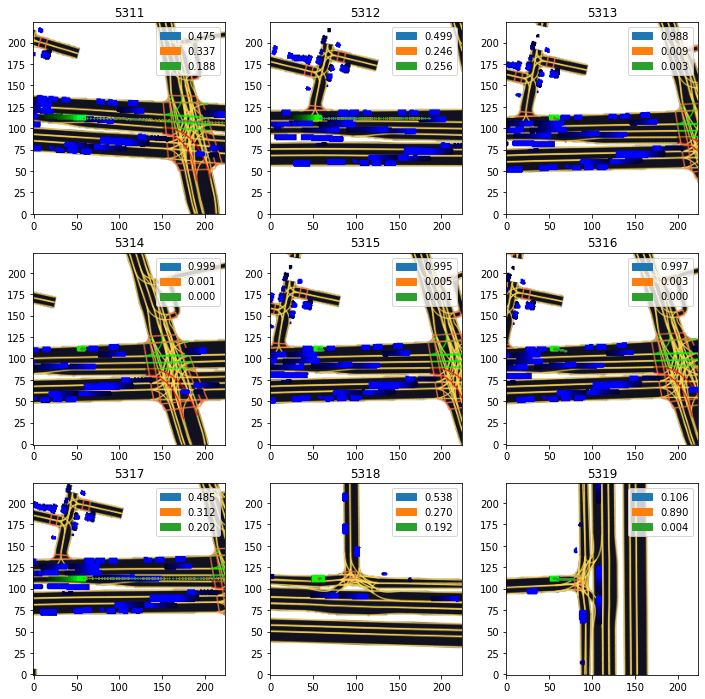

In [ ]:
plot_predicted_trajectory(agent_semantic_dataset, df_sub, list(range(5311, 5311+9)))

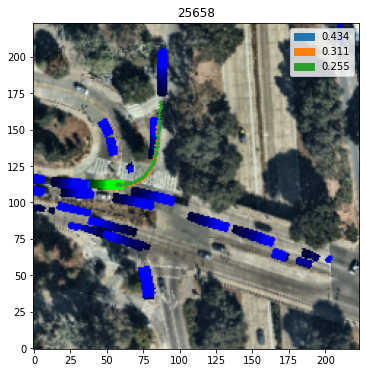

In [ ]:
# weird case
plot_predicted_trajectory(agent_satellite_dataset, df_sub, [25658], width=6, height=6, n_cols=1)

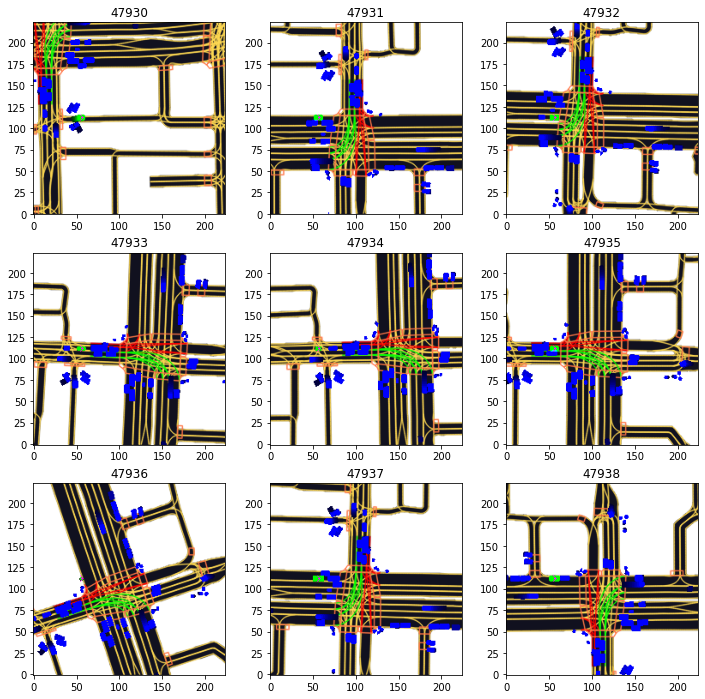

In [ ]:
# see what each agent were doing
plot_trajectory(agent_semantic_dataset, list(range(47930, 47930+9)))

### Here are videos

In [ ]:
scene_id = get_scene_index_from_frame_id(satellite_dataset, i_plots[0])

In [ ]:
plot_scene(semantic_dataset, scene_id)

In [ ]:
plot_scene(satellite_dataset, scene_id)

scene 53 : 5300 - 5399
